# Exploring Your Dataset for Machine Learning

With all analysis, machine learning or not, the best place to start is to get to grips with your dataset. In this notebook we will demonstrate how to use Python to visualise and characterise your dataset in preparation for both classical machine learning and deep neural networks.

## 1. Introducing the Breast Cancer Dataset

The dataset used in this series is the Breast Cancer Wisconsin Diagnostic Data Set, publicly available from the [University of California Irvine (UCI) Machine Learning Repository](https://archive.ics.uci.edu/dataset/17/breast+cancer+wisconsin+diagnostic). It consists of characteristics, or features (the machine learning term), of cell nuclei taken from breast masses which were sampled using fine-needle aspiration (FNA), a common diagnostic procedure in oncology. 

The clinical samples used to form this dataset were collected from January 1989 to November 1991. Relevant features were extracted from the digital images using Multisurface Method-Tree (K.P. Bennett 1992), a classification method that uses linear programming to construct a decision tree, a form of machine learning! An example of one of the digitised images from an FNA sample is given below.

![An example of an image of a breast mass from which dataset features were extracted](./assets/fna_pic.png)

## 1b. Knowing you dataset

Why is it important to understand the origins of your dataset? While the data points (features) collected today may theoretically be the same, the hardware used to collect them and the processing methods may differ. To the eye, they look identical, but there could be subtle changes in the patterns within your data. Our model, trained on this data, has learned the patterns and properties associated with this specific dataset, not necessarily the "true" characteristics of breast cancer cells. When asked to predict on cancer cells collected in 2025, it might give us incorrect answers, ones we could confidently trust given its strong performance on historical data. This phenomenon is called "dataset shift" or "distribution shift," and it's something you should always keep in mind when using someone else's data or even your own. Reproducibility is key!

## 2. Setting Up Our Environment

Now we understand our dataset, let's explore it. 

For this we will be using a combination of key data science packages in Python. Here is a brief description of each:

- **pandas**: A powerful data manipulation library that provides DataFrame structures for working with structured/tabular data
- **numpy**: The fundamental package for numerical computing in Python, providing support for arrays and mathematical functions
- **matplotlib**: A comprehensive plotting library for creating static, animated, and interactive visualisations
- **seaborn**: A statistical data visualisation library built on matplotlib that provides a high-level interface for drawing attractive statistical graphics
- **scikit-learn**: A machine learning library that provides simple and efficient tools for data analysis and modelling

Using a combination of these tools, we should be able to load, manipulate, and visualise our data effectively.

In [1]:
# Import our packages, giving some shorter aliases to make typing easier
import numpy as np  
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.decomposition import PCA

# Set visualisation style for consistency
sns.set_style('whitegrid')
plt.rcParams['figure.figsize'] = (10, 6)

## 3. Loading and Initial Inspection

It's always good to check the data to see if there's been any issues.

In [2]:
# Load the dataset
df = pd.read_csv('./data/breast_cancer.csv')

# Display basic information about the dataset
print(f"Dataset shape: {df.shape}")
print(f"Number of samples: {df.shape[0]}")
print(f"Number of features: {df.shape[1]}")

Dataset shape: (569, 31)
Number of samples: 569
Number of features: 31


In [3]:
# Display first few rows to understand the structure
df.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,0,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,0,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,0,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,0,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [4]:
# Check data types of all columns
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   diagnosis                569 non-null    int64  
 1   radius_mean              569 non-null    float64
 2   texture_mean             569 non-null    float64
 3   perimeter_mean           569 non-null    float64
 4   area_mean                569 non-null    float64
 5   smoothness_mean          569 non-null    float64
 6   compactness_mean         569 non-null    float64
 7   concavity_mean           569 non-null    float64
 8   concave points_mean      569 non-null    float64
 9   symmetry_mean            569 non-null    float64
 10  fractal_dimension_mean   569 non-null    float64
 11  radius_se                569 non-null    float64
 12  texture_se               569 non-null    float64
 13  perimeter_se             569 non-null    float64
 14  area_se                  5

## 4. Data Quality Checks

Data quality is crucial, null or non values will often crash machine learning models training functions, so we need to appropriately handle them straight away. There are none here as its a nicely formatted dataset prepared for others. But that's not oftent the case. 

You can handle null values by removing the row altogether, giving it a replacement value (such as zero), or interpolating its value based upon its other features.

In [5]:
# Check for missing values
missing_values = df.isnull().sum()
print("Missing values per column:")
print("-" * 50)
if missing_values.sum() == 0:
    print("No missing values")
else:
    print(missing_values[missing_values > 0])

Missing values per column:
--------------------------------------------------
No missing values


Duplicates are also a good one to check for, they occur more often than you think. Whilst a minor error, they will introduce slight favouring to the duplicated data point.

In [6]:
# Check for duplicate rows
duplicates = df.duplicated().sum()
print(f"Number of duplicate rows: {duplicates}")

Number of duplicate rows: 0


In [7]:
# if any of our rows were duplicated, we could filter then as so

df_deduped = df[df.duplicated()]

## 5. Target Variable Analysis

Understanding the distribution of our target variable is crucial for machine learning. Class imbalance can significantly affect model performance.

In [8]:
# Define class mapping for better readability
cls_dict = {0: 'benign', 1: 'malignant'}

# Analyse the distribution of the target variable
class_dist = df['diagnosis'].value_counts()

print("Distribution of classes:")
print("-" * 50)
print(f"Benign samples: {class_dist[0]} ({class_dist[0] / len(df) * 100:.1f}%)")
print(f"Malignant samples: {class_dist[1]} ({class_dist[1] / len(df) * 100:.1f}%)")
print(f"\nClass ratio (benign:malignant): {class_dist[0]/class_dist[1]:.2f}:1")

Distribution of classes:
--------------------------------------------------
Benign samples: 212 (37.3%)
Malignant samples: 357 (62.7%)

Class ratio (benign:malignant): 0.59:1


**Note on Class Imbalance**: An unbalanced distribution of classes in the target feature can affect your predictions with machine learning. If one class dominates, the algorithm might achieve high accuracy by simply predicting the majority class. In this dataset, we have a reasonable balance (approximately 1.6:1 ratio), though the benign class is slightly more prevalent.

## 6. Statistical Summary of Features

In [9]:
# Get statistical summary of numerical features
df_features = df.drop(columns=['diagnosis'])
df.describe().round(2)

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,569.00,569.00,569.00,569.00,569.00,569.00,569.00,569.00,569.00,569.00,...,569.00,569.00,569.00,569.00,569.00,569.00,569.00,569.00,569.00,569.00
mean,0.63,14.13,19.29,91.97,654.89,0.10,0.10,0.09,0.05,0.18,...,16.27,25.68,107.26,880.58,0.13,0.25,0.27,0.11,0.29,0.08
std,0.48,3.52,4.30,24.30,351.91,0.01,0.05,0.08,0.04,0.03,...,4.83,6.15,33.60,569.36,0.02,0.16,0.21,0.07,0.06,0.02
min,0.00,6.98,9.71,43.79,143.50,0.05,0.02,0.00,0.00,0.11,...,7.93,12.02,50.41,185.20,0.07,0.03,0.00,0.00,0.16,0.06
25%,0.00,11.70,16.17,75.17,420.30,0.09,0.06,0.03,0.02,0.16,...,13.01,21.08,84.11,515.30,0.12,0.15,0.11,0.06,0.25,0.07
50%,1.00,13.37,18.84,86.24,551.10,0.10,0.09,0.06,0.03,0.18,...,14.97,25.41,97.66,686.50,0.13,0.21,0.23,0.10,0.28,0.08
75%,1.00,15.78,21.80,104.10,782.70,0.11,0.13,0.13,0.07,0.20,...,18.79,29.72,125.40,1084.00,0.15,0.34,0.38,0.16,0.32,0.09
max,1.00,28.11,39.28,188.50,2501.00,0.16,0.35,0.43,0.20,0.30,...,36.04,49.54,251.20,4254.00,0.22,1.06,1.25,0.29,0.66,0.21


## 7. Feature Distributions

Understanding how features are distributed is essential for choosing appropriate preprocessing techniques and algorithms.

The pairplot from seaborn is a great starting tool, to see if their are any pairs of features that have clear differences between the classes. If you can see multiple pairs with visual differences between classes, there is a good chance a machine learning model will be accurate. Many may have slight separation with a lot of 'blur' between the classes, however in a higher dimensional space the boundry will hopefully be more defined.

In [10]:
sns.pairplot(df, hue = 'diagnosis', palette={0 : 'green', 1 : 'red'})

## 8. Feature Scaling and Comparison

Features often have different scales, which can bias certain machine learning algorithms and make it hard to compare. In particular, features whose units are larger can swamp the predictive space as they have a greater affect upon the algorithm. The next notebooks where we will be using the models we will always scale the data appropriately.

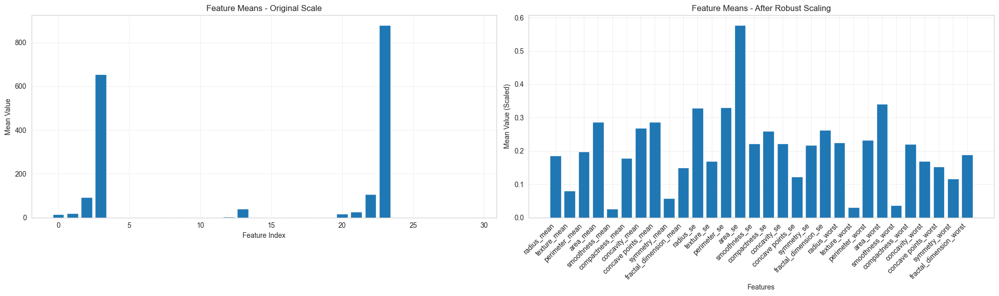

In [11]:
# Compare feature means before scaling
feature_means = df_features.mean()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 6))

# Original scale
ax1.bar(range(len(feature_means)), feature_means.values)
ax1.set_xlabel('Feature Index')
ax1.set_ylabel('Mean Value')
ax1.set_title('Feature Means - Original Scale')
ax1.grid(True, alpha=0.3)

# Apply robust scaling
scaler = RobustScaler()
scaled_features = scaler.fit_transform(df_features)
scaled_means = np.mean(scaled_features, axis=0)

# Scaled features
ax2.bar(df_features.columns, scaled_means)
ax2.set_xlabel('Features')
ax2.set_ylabel('Mean Value (Scaled)')
ax2.set_title('Feature Means - After Robust Scaling')
ax2.xaxis.set_ticks(np.arange(len(df_features.columns)))
ax2.set_xticklabels(df_features.columns, rotation=45, ha='right')
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

## 9. Feature Relationships and Correlations

Understanding relationships between features helps identify multicollinearity and potential feature engineering opportunities. Highly correlated features can affect the prediction quality of some machine learning algorithms, particualy linear/logiditc regression and linear SVMs. Tree based models and neural networks are more robust to correlated features.

They alaso effect our ability to determin feature importance, as correlated features essentialy caputre the same information.

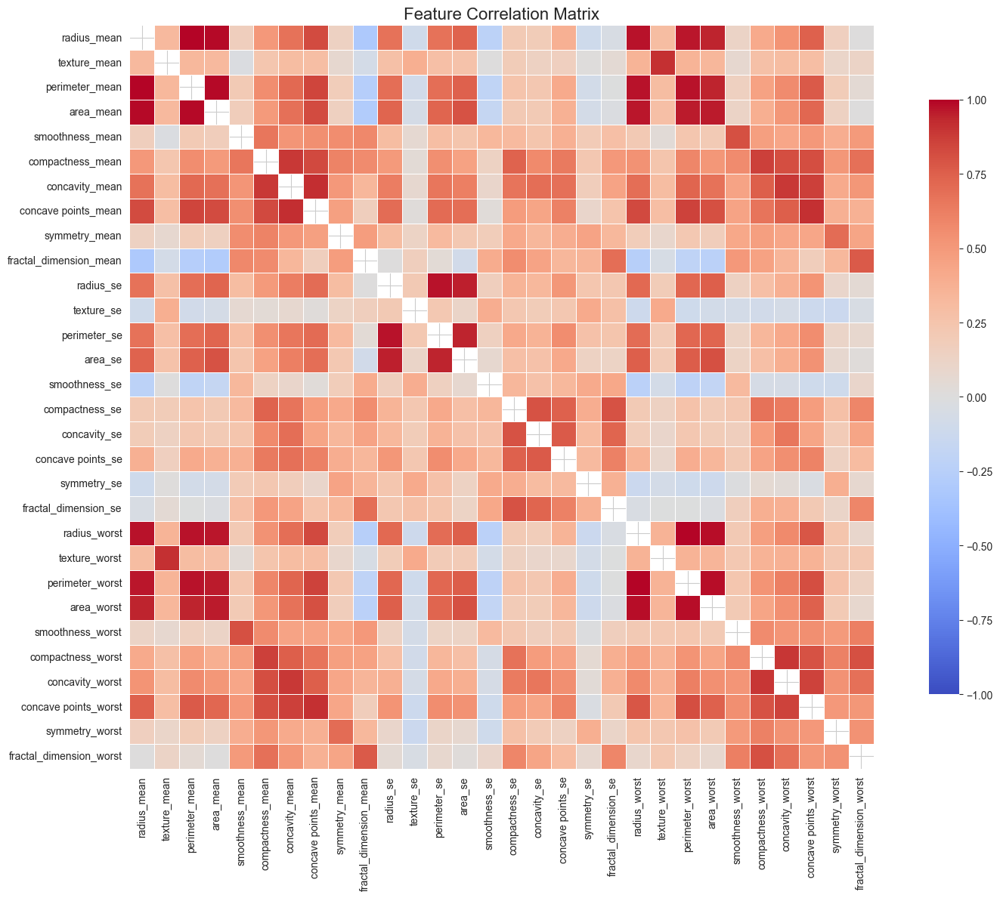

In [12]:
# Calculate correlation matrix
df_corr = df_features.corr()

# Create a mask for the diagonal (self-correlation)
mask = np.zeros_like(df_corr)
np.fill_diagonal(mask, True)

# Plot correlation heatmap
plt.figure(figsize=(16, 12))
sns.heatmap(df_corr, mask=mask, cmap='coolwarm', vmin=-1, vmax=1, 
            center=0, square=True, linewidths=0.5, 
            cbar_kws={"shrink": 0.8})
plt.title('Feature Correlation Matrix', fontsize=16)
plt.tight_layout()
plt.show()

In [13]:
# Find highly correlated feature pairs
threshold = 0.9
high_corr_pairs = []

for i in range(len(df_corr.columns)):
    for j in range(i+1, len(df_corr.columns)):
        if abs(df_corr.iloc[i, j]) > threshold:
            high_corr_pairs.append((
                df_corr.columns[i], 
                df_corr.columns[j], 
                df_corr.iloc[i, j]
            ))

print(f"Feature pairs with correlation > {threshold}:")
print("-" * 60)
for feat1, feat2, corr in sorted(high_corr_pairs, key=lambda x: abs(x[2]), reverse=True):
    print(f"{feat1:25} <-> {feat2:25} : {corr:.3f}")

Feature pairs with correlation > 0.9:
------------------------------------------------------------
radius_mean               <-> perimeter_mean            : 0.998
radius_worst              <-> perimeter_worst           : 0.994
radius_mean               <-> area_mean                 : 0.987
perimeter_mean            <-> area_mean                 : 0.987
radius_worst              <-> area_worst                : 0.984
perimeter_worst           <-> area_worst                : 0.978
radius_se                 <-> perimeter_se              : 0.973
perimeter_mean            <-> perimeter_worst           : 0.970
radius_mean               <-> radius_worst              : 0.970
perimeter_mean            <-> radius_worst              : 0.969
radius_mean               <-> perimeter_worst           : 0.965
area_mean                 <-> radius_worst              : 0.963
area_mean                 <-> area_worst                : 0.959
area_mean                 <-> perimeter_worst           : 0.959
radiu

From this we could remove one of the pair from some of the most highly correlated features, such as `perimeter_mean` and `perimeter_worst`. However, a much cleaner method that accounts for this is feature reduction through Principle Conponment Analysis (PCA). Which we'll explore below.

## 10. Dimensionality Reduction with PCA

Principal Component Analysis helps us understand the main sources of variation in our data, reducing our feature space to a more managle number.

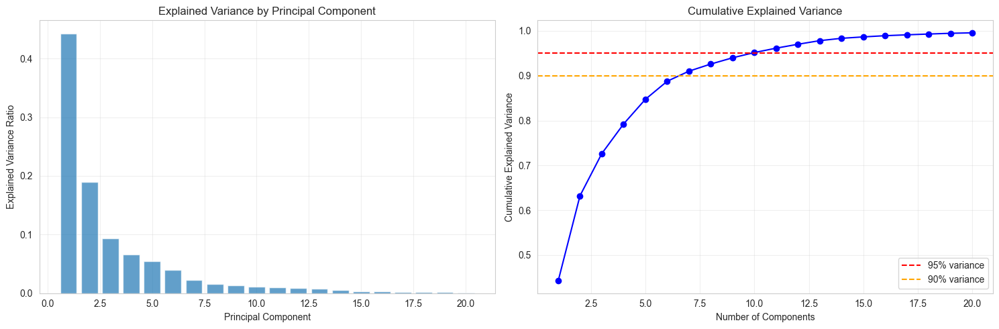

Components needed for 80% variance: 5
Components needed for 90% variance: 7
Components needed for 95% variance: 10
Components needed for 99% variance: 17


In [14]:
# Standardise features for PCA
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_features)

# Apply PCA
pca = PCA()
X_pca = pca.fit_transform(X_scaled)

# Visualise explained variance
explained_variance = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

# Individual explained variance
ax1.bar(range(1, min(21, len(explained_variance)+1)), 
        explained_variance[:20], alpha=0.7)
ax1.set_xlabel('Principal Component')
ax1.set_ylabel('Explained Variance Ratio')
ax1.set_title('Explained Variance by Principal Component')
ax1.grid(True, alpha=0.3)

# Cumulative explained variance
ax2.plot(range(1, min(21, len(cumulative_variance)+1)), 
         cumulative_variance[:20], 'bo-')
ax2.axhline(y=0.95, color='r', linestyle='--', label='95% variance')
ax2.axhline(y=0.90, color='orange', linestyle='--', label='90% variance')
ax2.set_xlabel('Number of Components')
ax2.set_ylabel('Cumulative Explained Variance')
ax2.set_title('Cumulative Explained Variance')
ax2.legend()
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Print number of components needed for different thresholds
for threshold in [0.80, 0.90, 0.95, 0.99]:
    n_components = np.argmax(cumulative_variance >= threshold) + 1
    print(f"Components needed for {threshold*100:.0f}% variance: {n_components}")

Gicen we get 95% of the variance explained with only 10 conponents, we could consisider only using these new features in our machine learning. This would reduce the computational load and simplify the state space to solve.

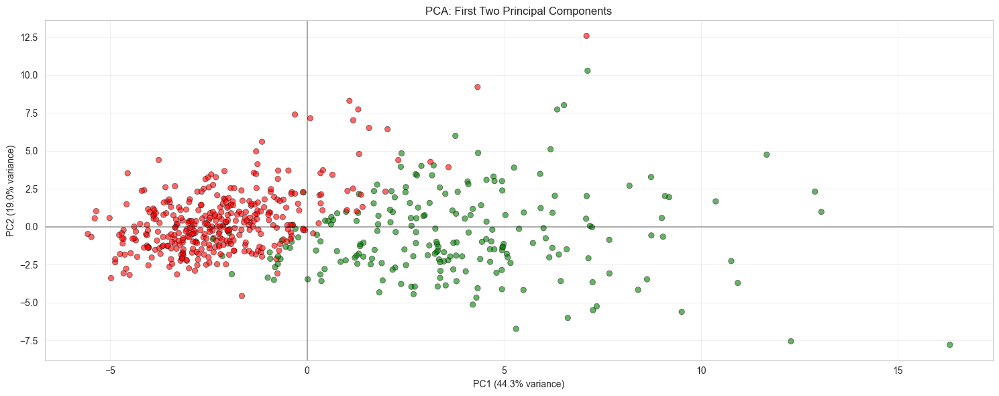

In [15]:
# Visualise data in PC space
colour_dict = {0: 'green', 1: 'red'}

fig, ax = plt.subplots(figsize=(15, 6))

# PC1 vs PC2
ax.scatter(X_pca[:, 0], X_pca[:, 1], 
                      c=df['diagnosis'].map(colour_dict), 
                      alpha=0.6, edgecolors='black', linewidth=0.5)
ax.set_xlabel(f'PC1 ({explained_variance[0]*100:.1f}% variance)')
ax.set_ylabel(f'PC2 ({explained_variance[1]*100:.1f}% variance)')
ax.set_title('PCA: First Two Principal Components')
ax.axhline(y=0, color='k', linestyle='-', alpha=0.3)
ax.axvline(x=0, color='k', linestyle='-', alpha=0.3)
ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()